In [144]:
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt
import seaborn as sns
import os
from sklearn.cluster import KMeans
import matplotlib.image


In [145]:
# Load the grayscale PNG images
def read_images(dir):
    images = os.listdir(dir)
    images = [i for i in images if i.endswith('.png')]
    images = [dir + i for i in images]
    return images

In [146]:
images_85k = read_images('./1A-85k-Data/')
images_135k = read_images('./1A-135k-Data/')
images_220k = read_images('./1A-2200k-Data/')

i=0
print(images_85k[i], images_135k[i], images_220k[i])

./1A-85k-Data/slice1000.png ./1A-135k-Data/slice1000-.png ./1A-2200k-Data/1000.png


In [147]:
def load_preprocess_image(image_path, crop):
    image = Image.open(image_path).convert('L')  # Convert to grayscale (L mode)
    # Crop the image to the region of interest
    image = image.crop(crop)
    image = image.resize((550, 550), Image.LANCZOS)
    kmeans = KMeans(n_clusters=2, random_state=42)
    image = np.array(image, dtype='int16')
    new = image.reshape(-1, 1)
    kmeans.fit(new)
    labels = kmeans.labels_.reshape((550,550))
    image[labels==0] = 0
    return image



Similarity Score: 0.8039
Similarity Score: 0.7986
Similarity Score: 0.7149
Similarity Score: 0.7833
Similarity Score: 0.7755
Similarity Score: 0.8187
Similarity Score: 0.7653
Similarity Score: 0.8321
Similarity Score: 0.8302
Similarity Score: 0.7820
Similarity Score: 0.8105
Similarity Score: 0.8377
Similarity Score: 0.8349
Similarity Score: 0.8000
Similarity Score: 0.8199
Similarity Score: 0.8007
Similarity Score: 0.8098
Similarity Score: 0.8062
Similarity Score: 0.7214
Similarity Score: 0.8349
Similarity Score: 0.0702
Similarity Score: 0.7746
Similarity Score: 0.7890
Similarity Score: 0.8357


C:\Users\Windows\AppData\Local\Temp\ipykernel_16012\3094028111.py:79: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=(15, 5))


Similarity Score: 0.7927
Similarity Score: 0.7831
Similarity Score: 0.8250
Similarity Score: 0.8024
Similarity Score: 0.8330
Similarity Score: 0.8030
Similarity Score: 0.0018
Similarity Score: 0.6840
Similarity Score: 0.7398
Similarity Score: 0.7945
Similarity Score: 0.1095
Similarity Score: 0.0700
Similarity Score: 0.0174
Similarity Score: 0.4180
Similarity Score: 0.0983
Similarity Score: 0.8482
Similarity Score: 0.8250
Similarity Score: 0.8171
Similarity Score: 0.7973
Similarity Score: 0.7743
Similarity Score: 0.8222
Similarity Score: 0.8069
Similarity Score: 0.8203
Similarity Score: 0.7743


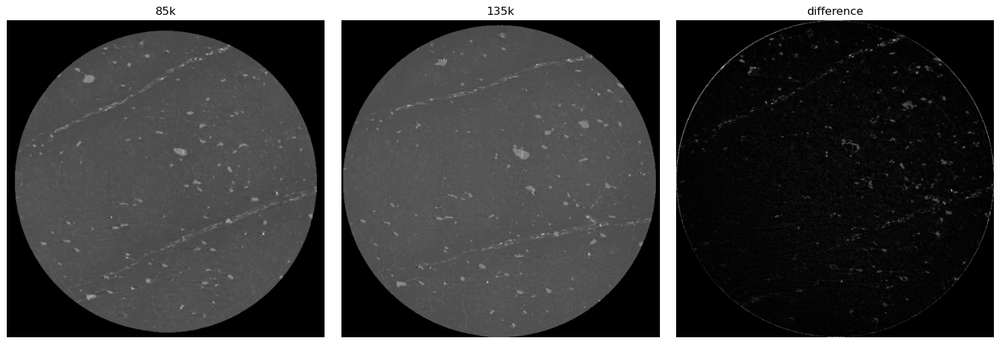

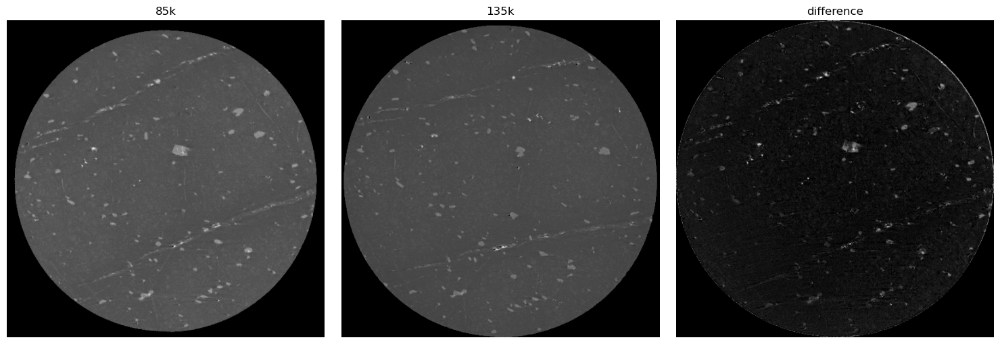

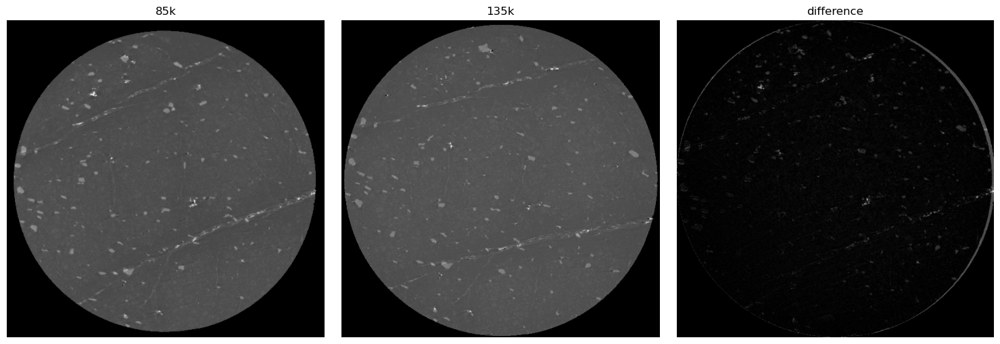

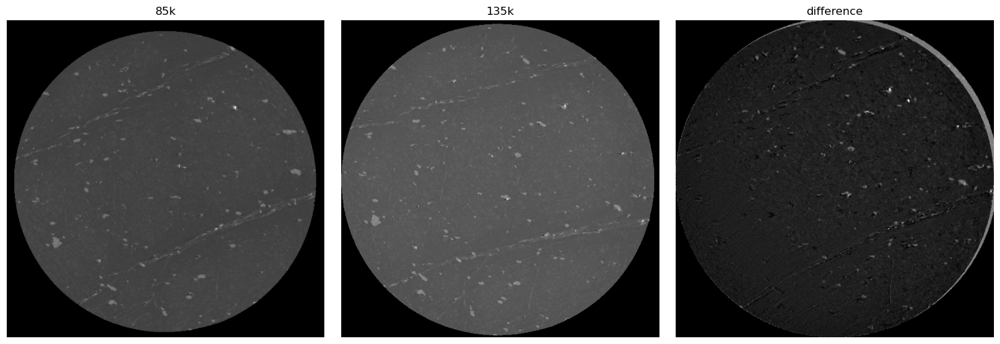

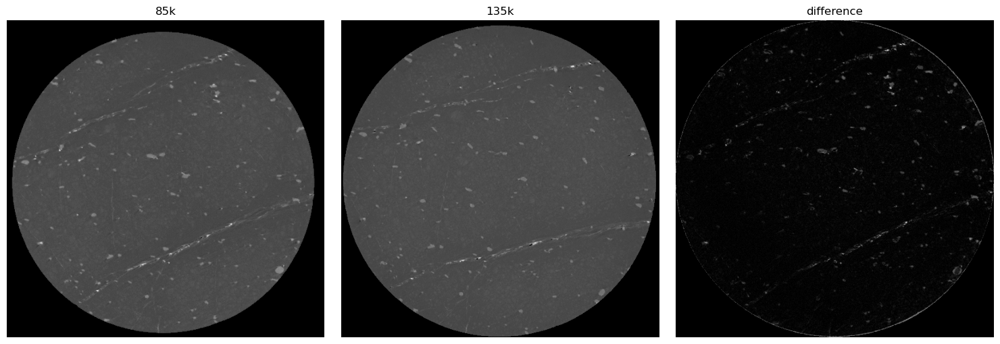

...

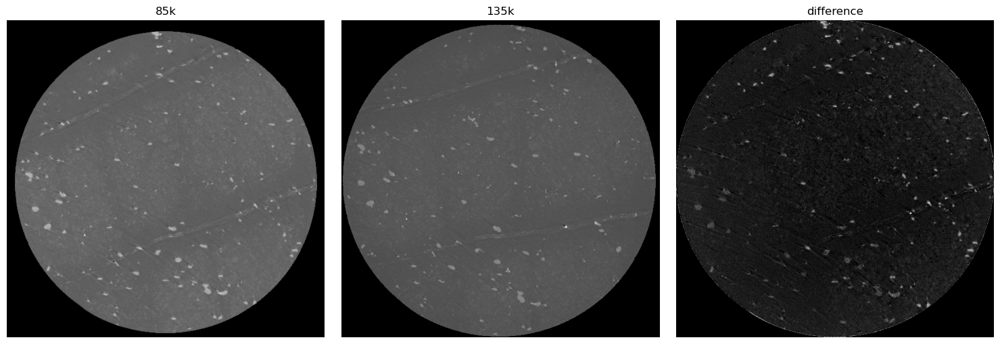

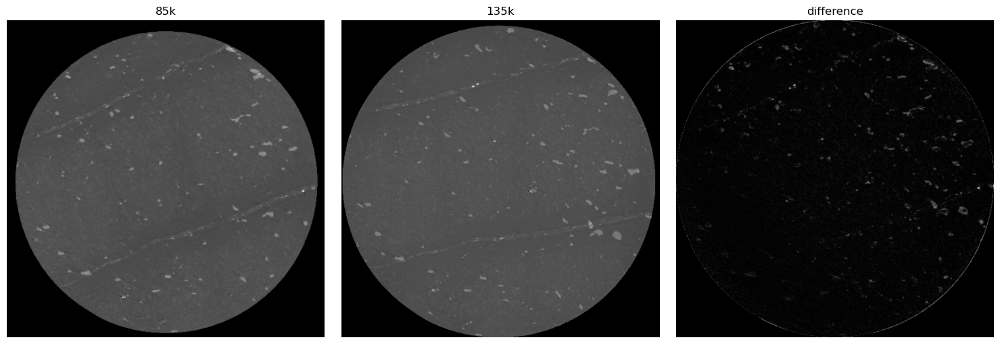

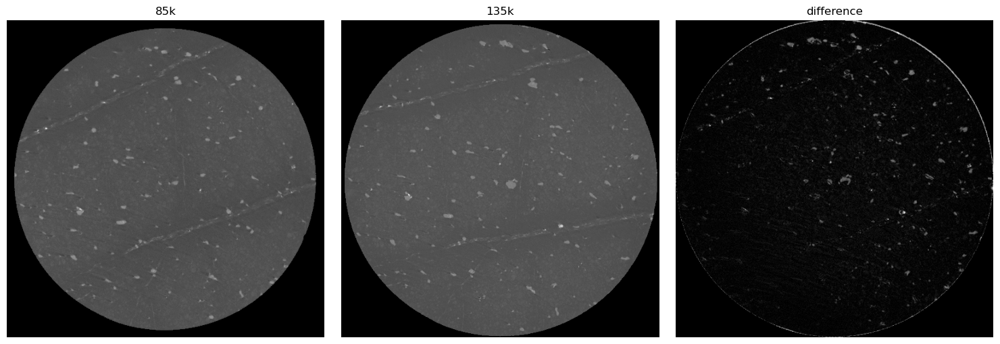

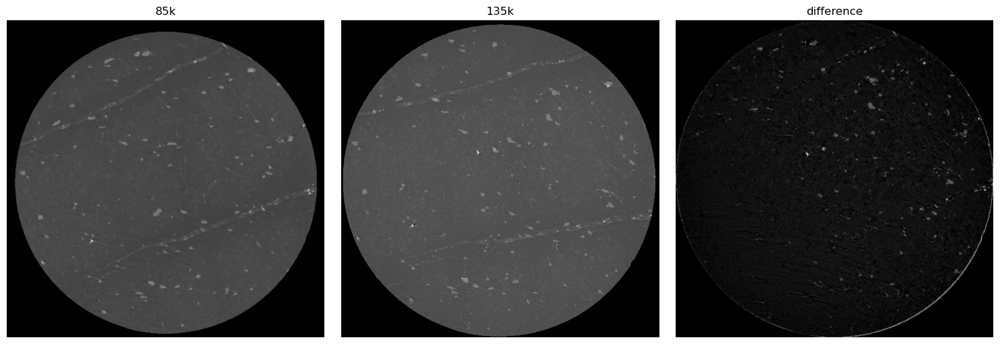

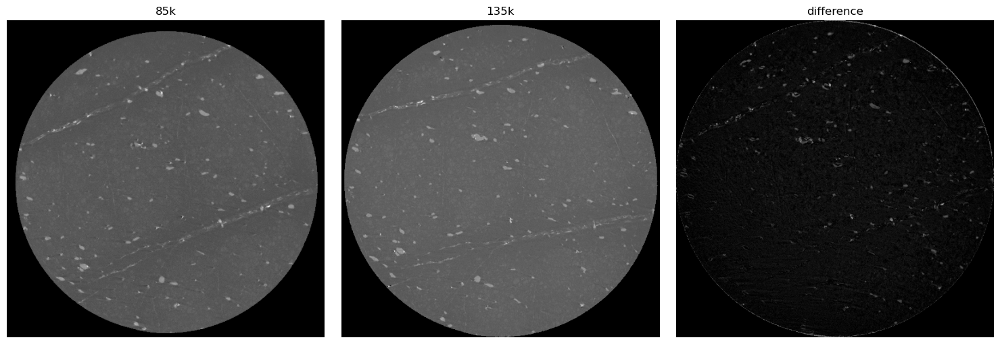

In [155]:
import cv2
import numpy as np
from skimage.metrics import structural_similarity as ssim

def align_images(img1, img2):
    # Convert images to grayscale
    gray1 = cv2.cvtColor(img1, cv2.COLOR_BGR2GRAY)
    gray2 = cv2.cvtColor(img2, cv2.COLOR_BGR2GRAY)

    # Detect ORB keypoints and descriptors
    orb = cv2.ORB_create()
    keypoints1, descriptors1 = orb.detectAndCompute(gray1, None)
    keypoints2, descriptors2 = orb.detectAndCompute(gray2, None)

    # Match keypoints using BFMatcher
    matcher = cv2.BFMatcher(cv2.NORM_HAMMING, crossCheck=True)
    matches = matcher.match(descriptors1, descriptors2)
    matches = sorted(matches, key=lambda x: x.distance)

    # Extract location of matched keypoints
    points1 = np.float32([keypoints1[m.queryIdx].pt for m in matches]).reshape(-1, 1, 2)
    points2 = np.float32([keypoints2[m.trainIdx].pt for m in matches]).reshape(-1, 1, 2)

    # Compute homography matrix
    matrix, mask = cv2.findHomography(points2, points1, cv2.RANSAC, 5.0)

    # Warp the second image to align with the first
    height, width, _ = img1.shape
    aligned_img2 = cv2.warpPerspective(img2, matrix, (width, height))

    return aligned_img2

def crop_to_overlap(img1, img2):
    # Find overlapping region
    gray1 = cv2.cvtColor(img1, cv2.COLOR_BGR2GRAY)
    gray2 = cv2.cvtColor(img2, cv2.COLOR_BGR2GRAY)

    _, binary1 = cv2.threshold(gray1, 1, 255, cv2.THRESH_BINARY)
    _, binary2 = cv2.threshold(gray2, 1, 255, cv2.THRESH_BINARY)

    overlap = cv2.bitwise_and(binary1, binary2)
    x, y, w, h = cv2.boundingRect(overlap)

    return img1[y:y+h, x:x+w], img2[y:y+h, x:x+w]

def calculate_similarity(img1, img2):
    gray1 = cv2.cvtColor(img1, cv2.COLOR_BGR2GRAY)
    gray2 = cv2.cvtColor(img2, cv2.COLOR_BGR2GRAY)
    score, _ = ssim(gray1, gray2, full=True)
    return score

for i in range(48):
    image_sample_85k = load_preprocess_image(images_85k[i], (380, 170, 930, 720))
    image_sample_135k = load_preprocess_image(images_135k[i], (280, 100, 1000, 820))
    image_sample_220k = load_preprocess_image(images_220k[i], (280, 80, 1050, 830))

    matplotlib.image.imsave('image_sample_85k.png', image_sample_85k, cmap='gray')
    matplotlib.image.imsave('image_sample_135k.png', image_sample_135k, cmap='gray')
    matplotlib.image.imsave('image_sample_220k.png', image_sample_220k, cmap='gray')
    # Load images
    img1 = cv2.imread('image_sample_85k.png')
    img2 = cv2.imread('image_sample_135k.png')

    # Align images
    aligned_img2 = align_images(img1, img2)

    # Crop to overlapping region
    cropped_img1, cropped_img2 = crop_to_overlap(img1, aligned_img2)

    # Calculate similarity
    similarity = calculate_similarity(cropped_img1, cropped_img2)
    print(f"Similarity Score: {similarity:.4f}")

    if similarity > 0.75:
        cropped_img1 = np.mean(cropped_img1, axis=-1)
        cropped_img2 = np.mean(cropped_img2, axis=-1)
        new = np.abs(cropped_img1 - cropped_img2)
        # Save results
        plt.figure(figsize=(15, 5))
        plt.subplot(1, 3, 1)
        plt.title("85k")
        plt.imshow(image_sample_85k, cmap="gray")
        plt.axis("off")

        plt.subplot(1, 3, 2)
        plt.title("135k")
        plt.imshow(image_sample_135k, cmap="gray")
        plt.axis("off")

        plt.subplot(1, 3, 3)
        plt.title("difference")
        plt.imshow(new, cmap="gray")
        plt.axis("off")
        plt.tight_layout()
        plt.savefig('./energies_135k_85k/' + images_85k[i].split('/')[-1])
    
    # cv2.imwrite('cropped_img2.jpg', new)

# Display results
# cv2.imshow('Image 1', img1)
# cv2.imshow('Aligned Image 2', aligned_img2)
# cv2.imshow('Cropped Image 1', cropped_img1)
# cv2.imshow('Cropped Image 2', cropped_img2)
# cv2.waitKey(0)
# cv2.destroyAllWindows()
